In [4]:
#@markdown Check type of GPU and VRAM available.
!nvidia-smi --query-gpu=name,memory.total,memory.free --format=csv,noheader

Tesla P100-PCIE-16GB, 16384 MiB, 16276 MiB


## Подготовка данных

1. Собрать датасет от 15 изображений одно персонажа (Чем более разнооразнее и больше данных тем лучше будет качество)
2. Кропнуть и заресайзить лица, тут можно обрабатывать сразу все https://www.birme.net/



## Install Requirements

In [2]:
!rm -r /kaggle/working/diffusers

In [5]:
%pip install -U peft

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.1/199.1 kB 4.5 MB/s eta 0:00:0000:01
Note: you may need to restart the kernel to use updated packages.


In [19]:
cd /kaggle/working

/kaggle/working


In [20]:
!git clone https://github.com/huggingface/diffusers
%pip install git+https://github.com/huggingface/diffusers
%pip install triton
%pip install accelerate transformers ftfy gradio natsort safetensors
%pip install bitsandbytes

Cloning into 'diffusers'...
remote: Enumerating objects: 59986, done.
remote: Counting objects: 100% (1953/1953), done.
remote: Compressing objects: 100% (1024/1024), done.
remote: Total 59986 (delta 1333), reused 1295 (delta 823), pack-reused 58033
Receiving objects: 100% (59986/59986), 41.95 MiB | 22.71 MiB/s, done.
Resolving deltas: 100% (43407/43407), done.
  Cloning https://github.com/huggingface/diffusers to /tmp/pip-req-build-zvbm5aqf
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/diffusers /tmp/pip-req-build-zvbm5aqf
  Resolved https://github.com/huggingface/diffusers to commit 6133d98ff70eafad7b9f65da50a450a965d1957f
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for diffusers: filename=diffusers-0.28.0.dev0-py3-none-any.whl size=2037416 sha256=15a3d91554758fe4a8e375c38f466a783911d7860444c02f7539a9c524fc7bf7
  Stored in directory: /tmp/

In [6]:
# !rm -r out
# !rm -r class_images
# !rm logs.zip

In [6]:
!rm -r cache

rm: cannot remove 'cache': No such file or directory


In [9]:
!pip list | grep torch

pytorch-ignite                           0.4.13
pytorch-lightning                        2.2.1
torch                                    2.1.2
torchaudio                               2.1.2
torchdata                                0.7.1
torchinfo                                1.8.0
torchmetrics                             1.3.2
torchtext                                0.16.2
torchvision                              0.16.2


## Download model and convert model

In [8]:
# !wget https://civitai.com/api/download/models/201259?type=Model&format=SafeTensor&size=pruned&fp=fp16

In [9]:
# !wget -O civitai_midel.ckpt https://civitai.com/api/download/models/201259?type=Model&format=SafeTensor&size=pruned&fp=fp16
!wget https://raw.githubusercontent.com/CompVis/stable-diffusion/main/configs/stable-diffusion/v1-inference.yaml

--2024-04-04 15:48:12--  https://raw.githubusercontent.com/CompVis/stable-diffusion/main/configs/stable-diffusion/v1-inference.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1873 (1.8K) [text/plain]
Saving to: 'v1-inference.yaml.2'

v1-inference.yaml.2 100%[===================>]   1.83K  --.-KB/s    in 0s      

2024-04-04 15:48:12 (26.2 MB/s) - 'v1-inference.yaml.2' saved [1873/1873]



In [10]:
# !mkdir cache

In [11]:
# !python diffusers/scripts/convert_original_stable_diffusion_to_diffusers.py \
#       --checkpoint_path='civitai_midel.ckpt'\
#       --original_config_file='v1-inference.yaml'\
#       --dump_path='/cache'\
#       --scheduler_type="ddim" --prediction_type='epsilon'\
#       --from_safetensors

## Settings and run

# Start Training

Use the table below to choose the best flags based on your memory and speed requirements. Tested on Tesla T4 GPU.


| `fp16` | `train_batch_size` | `gradient_accumulation_steps` | `gradient_checkpointing` | `use_8bit_adam` | GB VRAM usage | Speed (it/s) |
| ---- | ------------------ | ----------------------------- | ----------------------- | --------------- | ---------- | ------------ |
| fp16 | 1                  | 1                             | TRUE                    | TRUE            | 9.92       | 0.93         |
| no   | 1                  | 1                             | TRUE                    | TRUE            | 10.08      | 0.42         |
| fp16 | 2                  | 1                             | TRUE                    | TRUE            | 10.4       | 0.66         |
| fp16 | 1                  | 1                             | FALSE                   | TRUE            | 11.17      | 1.14         |
| no   | 1                  | 1                             | FALSE                   | TRUE            | 11.17      | 0.49         |
| fp16 | 1                  | 2                             | TRUE                    | TRUE            | 11.56      | 1            |
| fp16 | 2                  | 1                             | FALSE                   | TRUE            | 13.67      | 0.82         |
| fp16 | 1                  | 2                             | FALSE                   | TRUE            | 13.7       | 0.83          |
| fp16 | 1                  | 1                             | TRUE                    | FALSE           | 15.79      | 0.77         |


Add `--gradient_checkpointing` flag for around 9.92 GB VRAM usage.

remove `--use_8bit_adam` flag for full precision. Requires 15.79 GB with `--gradient_checkpointing` else 17.8 GB.

remove `--train_text_encoder` flag to reduce memory usage further, degrades output quality.

In [12]:
# !mkdir /kaggle/working/class_images

In [13]:
!mkdir /kaggle/working/out
!mkdir /kaggle/working/out/dreambooth

In [5]:
import os
os.environ['INSTANCE_DIR'] = "/kaggle/input/zenday2"
os.environ['CLASS_DIR'] = "/kaggle/input/regularization-images-woman"

os.environ['MODEL_NAME'] = "/kaggle/input/sd-weights/content/cache_dir/models/civitai_model"
os.environ['OUTPUT_DIR'] = "/kaggle/working/out/dreambooth"


In [10]:
# import wandb

In [11]:
# os.environ["WANDB_PROJECT"] = "sd_tuning"
# os.environ["WANDB_ENTITY"] = "t-ionov"
# os.environ["WANDB_LOG_MODEL"] = "false"
# os.environ["WANDB_WATCH"] = "all"
# # os.environ["CUDA_VISIBLE_DEVICES"]="0"

In [12]:
# !zip -r class_images.zip class_images/

In [13]:
import torch

In [14]:
torch.cuda.empty_cache()

In [15]:
len(os.listdir(os.environ['INSTANCE_DIR']))

27

In [16]:
len(os.listdir(os.environ['CLASS_DIR']))

501

In [25]:
!python3 /kaggle/working/diffusers/examples/dreambooth/train_dreambooth.py \
  --pretrained_model_name_or_path=$MODEL_NAME \
  --instance_data_dir=$INSTANCE_DIR \
  --class_data_dir=$CLASS_DIR \
  --output_dir=$OUTPUT_DIR \
  --instance_prompt="a photo of sks woman face" \
  --class_prompt="a photo of woman face" \
  --with_prior_preservation --prior_loss_weight=1.0 \
  --resolution=512 \
  --train_batch_size=1 \
  --learning_rate=2e-6 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=0 \
  --gradient_accumulation_steps=1 \
  --num_class_images=500 \
  --max_train_steps=900 \
  --checkpointing_steps=99999999 \
  --use_8bit_adam \
  --mixed_precision="no"\
  --train_text_encoder \
  --report_to="tensorboard" \
  --validation_prompt="portrait of sks woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes" \
  --validation_steps=500

2024-04-04 15:49:54.691727: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-04 15:49:54.691824: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-04 15:49:54.834984: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
{'variance_type'} was not found in config. Values will be initialized to default values.
/opt/conda/lib/python3.10/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed

In [26]:
# %load_ext tensorboard
# %tensorboard --logdir /kaggle/working/out/dreambooth/logs

In [27]:
# !zip -r logs.zip /kaggle/working/out/dreambooth/logs

## Inference

In [28]:
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler
from IPython.display import display
import os

model_path = os.environ['OUTPUT_DIR']

pipe = StableDiffusionPipeline.from_pretrained(model_path, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)
g_cuda=None

2024-04-04 16:13:51.853552: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-04 16:13:51.853605: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-04 16:13:51.855066: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [29]:
#@markdown Can set random seed here for reproducibility.
g_cuda = torch.Generator(device='cuda')
seed = 345252 #@param {type:"number"}
g_cuda.manual_seed(seed)

In [30]:
from PIL import Image

  0%|          | 0/55 [00:00<?, ?it/s]

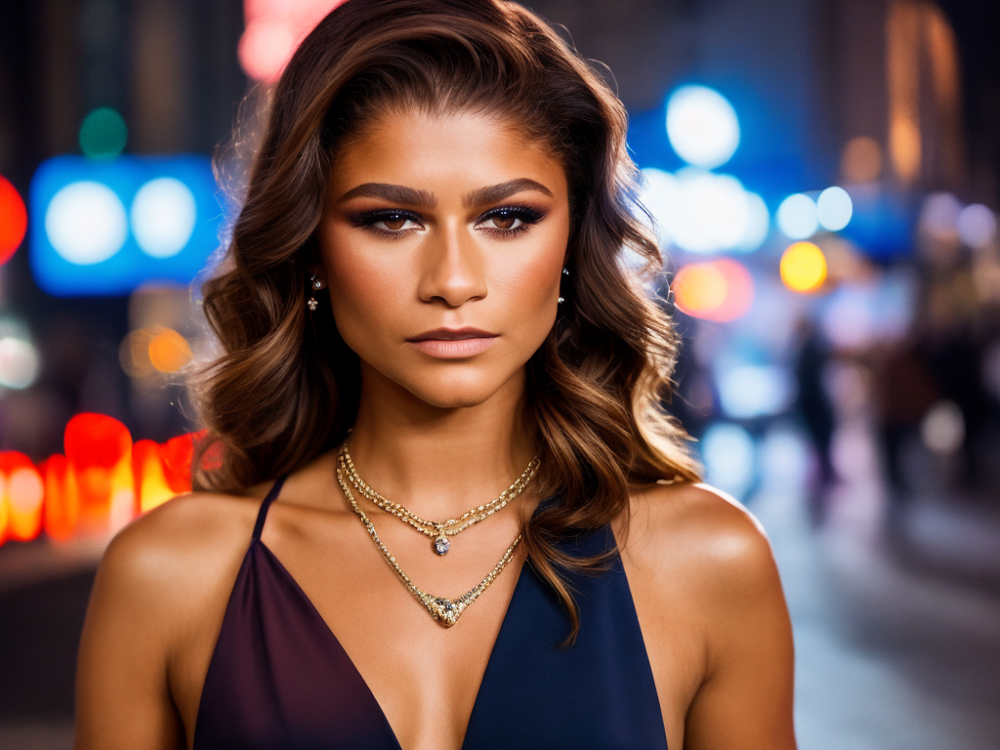

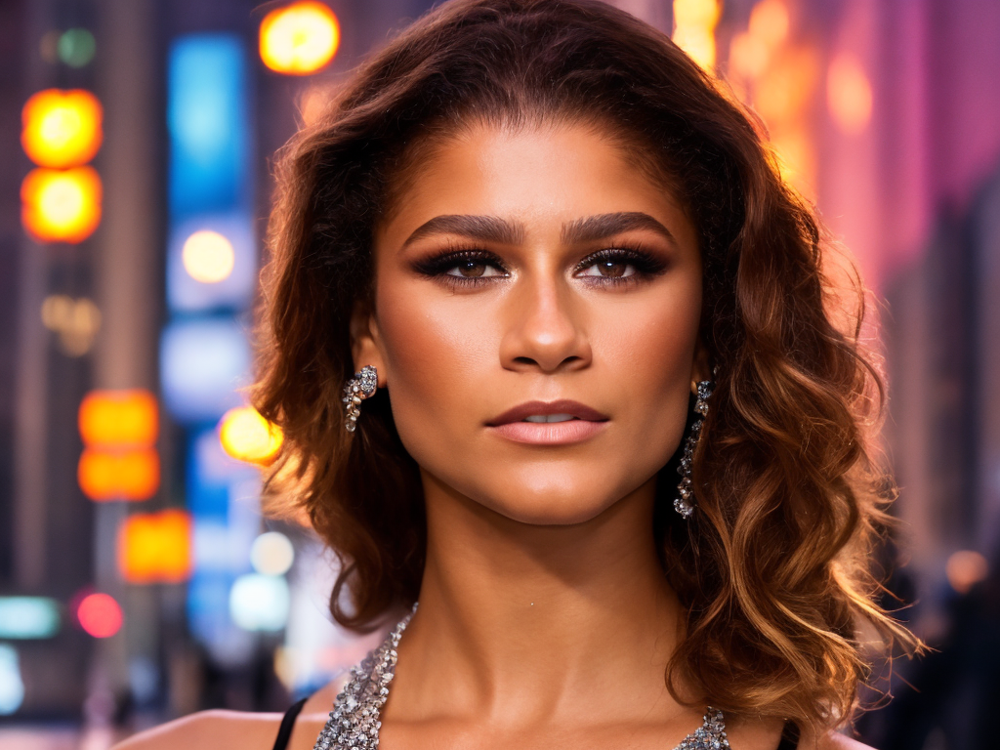

In [44]:
prompt = "portrait of sks woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus, beautiful, young,  beautiful eyes, detailed eyes" #@param {type:"string"}
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation" #@param {type:"string"}
num_samples = 2 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 55 #@param {type:"number"}
height = 768 #@param {type:"number"}
width = 1024 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

  0%|          | 0/55 [00:00<?, ?it/s]

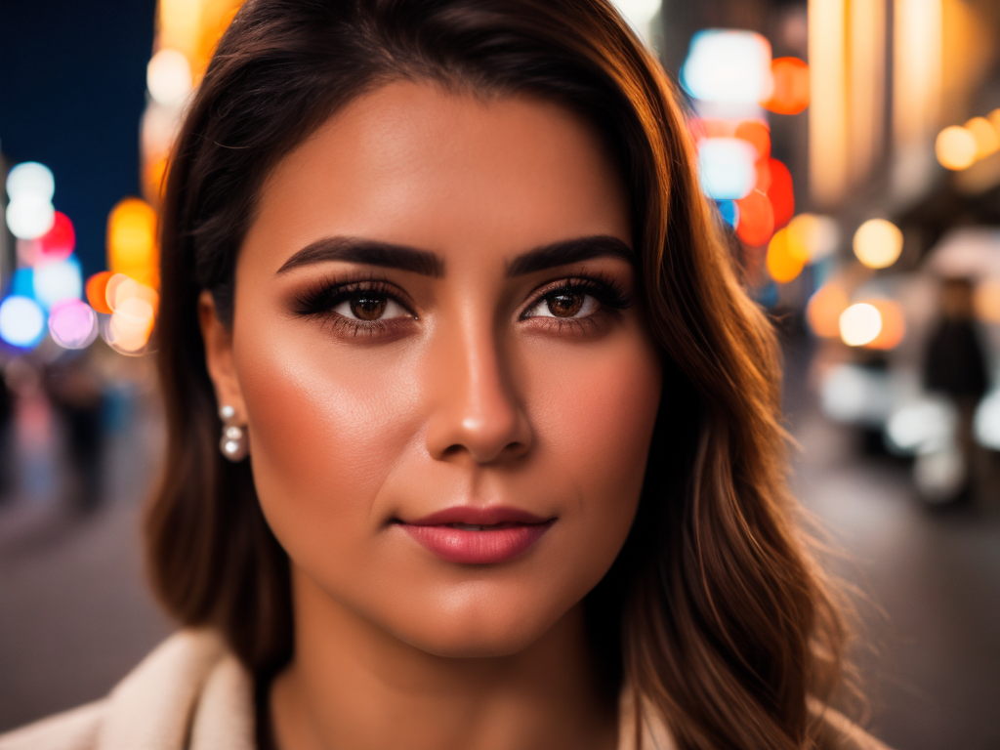

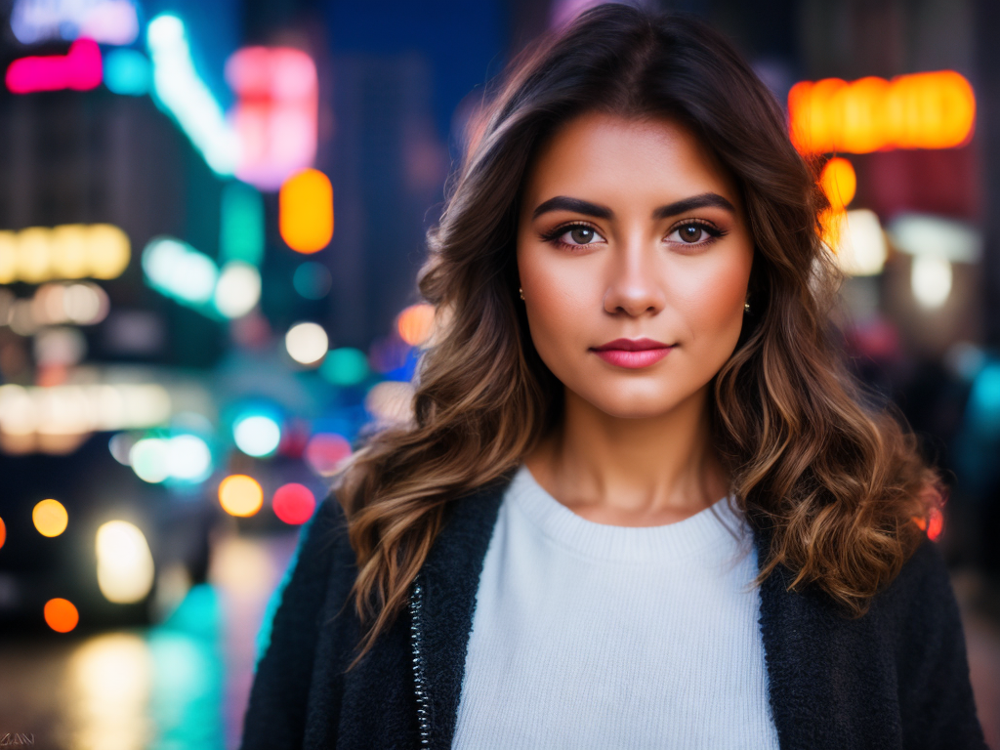

In [45]:
prompt = "portrait of woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes" #@param {type:"string"}
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation" #@param {type:"string"}
num_samples = 2 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 55 #@param {type:"number"}
height = 768 #@param {type:"number"}
width = 1024 #@param {type:"number"}

with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

In [46]:
from PIL import Image
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [47]:
token = "sks"
promtp_list = [
    {
     "name": "kitchen",
     "prompt":f"close up portrait of {token} woman face, in the kitchen, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation",
    },
    {
     "name": "forest",
     "prompt":f"portrait of {token} woman face, in the forest, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation",
    },
    {
     "name": "street",
     "prompt":f"portrait of {token} woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
    {
     "name": "desert",
     "prompt":f"portrait of {token} woman face, on the desert, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
    {
     "name": "beach",
     "prompt":f"portrait of {token} woman face, on the beach, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
]

In [48]:
len(promtp_list)

5

In [49]:
!mkdir images

In [17]:
save_folder = "images"

In [53]:
seed = 147525234
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 45
height = 768
width = 1024

save_mode = "with_train_token"


for idx, sample in enumerate(promtp_list):
    prompt = sample.get("prompt")
    negative_prompt = sample.get("n_prompt")
    name = sample.get("name")
    generator = torch.Generator("cuda").manual_seed(seed)
    with autocast("cuda"), torch.inference_mode():
        images = pipe(
            prompt,
            height=height,
            width=width,
            negative_prompt=negative_prompt,
            num_images_per_prompt=1,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator
        ).images
    image = images[0]
    
    save_path = os.path.join(save_folder, save_mode)
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    image.save(os.path.join(save_path, f'{height}x{width}_{name}.jpg'))
    
    

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

In [18]:
token = ""
promtp_list = [
    {
     "name": "kitchen",
     "prompt":f"close up portrait of {token} woman face, in the kitchen, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation",
    },
    {
     "name": "forest",
     "prompt":f"portrait of {token} woman face, in the forest, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation",
    },
    {
     "name": "street",
     "prompt":f"portrait of {token} woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
    {
     "name": "desert",
     "prompt":f"portrait of {token} woman face, on the desert, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
    {
     "name": "beach",
     "prompt":f"portrait of {token} woman face, on the beach, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
]

In [57]:
!zip -r images.zip images

  adding: images/ (stored 0%)
  adding: images/base_model/ (stored 0%)
  adding: images/base_model/768x1024_street.jpg (deflated 1%)
  adding: images/base_model/768x1024_forest.jpg (deflated 0%)
  adding: images/base_model/768x1024_kitchen.jpg (deflated 1%)
  adding: images/base_model/768x1024_desert.jpg (deflated 2%)
  adding: images/base_model/768x1024_beach.jpg (deflated 1%)
  adding: images/with_train_token/ (stored 0%)
  adding: images/with_train_token/768x1024_street.jpg (deflated 0%)
  adding: images/with_train_token/768x1024_forest.jpg (deflated 0%)
  adding: images/with_train_token/768x1024_kitchen.jpg (deflated 3%)
  adding: images/with_train_token/768x1024_desert.jpg (deflated 2%)
  adding: images/with_train_token/768x1024_beach.jpg (deflated 1%)


In [55]:
seed = 147525234
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 45
height = 768
width = 1024

save_mode = "base_model"


for idx, sample in enumerate(promtp_list):
    prompt = sample.get("prompt")
    negative_prompt = sample.get("n_prompt")
    name = sample.get("name")
    generator = torch.Generator("cuda").manual_seed(seed)
    with autocast("cuda"), torch.inference_mode():
        images = pipe(
            prompt,
            height=height,
            width=width,
            negative_prompt=negative_prompt,
            num_images_per_prompt=1,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator
        ).images
    image = images[0]
    
    save_path = os.path.join(save_folder, save_mode)
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    image.save(os.path.join(save_path, f'{height}x{width}_{name}.jpg'))
    
    

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

In [58]:
# !zip -r out.zip out

  adding: out/ (stored 0%)
  adding: out/dreambooth/ (stored 0%)
  adding: out/dreambooth/text_encoder/ (stored 0%)
  adding: out/dreambooth/text_encoder/config.json (deflated 46%)
  adding: out/dreambooth/text_encoder/model.safetensors (deflated 18%)
  adding: out/dreambooth/safety_checker/ (stored 0%)
  adding: out/dreambooth/safety_checker/config.json (deflated 51%)
  adding: out/dreambooth/safety_checker/model.safetensors (deflated 41%)
  adding: out/dreambooth/logs/ (stored 0%)
  adding: out/dreambooth/logs/dreambooth/ (stored 0%)
  adding: out/dreambooth/logs/dreambooth/events.out.tfevents.1712245861.ca44a688b484.150.0 (deflated 3%)
  adding: out/dreambooth/logs/dreambooth/1712245861.976755/ (stored 0%)
  adding: out/dreambooth/logs/dreambooth/1712245861.976755/hparams.yml (deflated 51%)
  adding: out/dreambooth/logs/dreambooth/1712245861.9741228/ (stored 0%)
  adding: out/dreambooth/logs/dreambooth/1712245861.9741228/events.out.tfevents.1712245861.ca44a688b484.150.1 (deflated 56

In [64]:
# !rm out.zip

In [59]:
!mkdir out_lora

In [66]:
torch.cuda.empty_cache()

In [20]:
!git clone https://github.com/huggingface/peft

Cloning into 'peft'...
remote: Enumerating objects: 7037, done.
remote: Counting objects: 100% (1550/1550), done.
remote: Compressing objects: 100% (446/446), done.
remote: Total 7037 (delta 1283), reused 1236 (delta 1076), pack-reused 5487
Receiving objects: 100% (7037/7037), 10.85 MiB | 21.45 MiB/s, done.
Resolving deltas: 100% (4650/4650), done.


In [21]:
cd peft/examples/lora_dreambooth

/kaggle/working/peft/examples/lora_dreambooth


In [22]:
!pip install -r requirements.txt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.1/84.1 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 43.6 MB/s eta 0:00:0000:01


In [11]:
!pip install git+https://github.com/huggingface/peft

  Cloning https://github.com/huggingface/peft to /tmp/pip-req-build-iablilb9
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/peft /tmp/pip-req-build-iablilb9
  Resolved https://github.com/huggingface/peft to commit 26726bf1ddee6ca75ed4e1bfd292094526707a78
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for peft: filename=peft-0.10.1.dev0-py3-none-any.whl size=200819 sha256=9ef331c06b78447605f0508c4ddc201498602a47d1f7db429d6cb3c588e37f3a
  Stored in directory: /tmp/pip-ephem-wheel-cache-9821hvlw/wheels/4c/16/67/1002a2d4daa822eff130e6d85b90051b75d2ce0d26b9448e4a
Successfully built peft


In [12]:
# rm -r /kaggle/working/lora2

In [22]:
os.environ['INSTANCE_DIR'] = "/kaggle/input/zenday2"
os.environ['CLASS_DIR'] = "/kaggle/input/regularization-images-woman"

os.environ['MODEL_NAME'] = "/kaggle/input/sd-weights/content/cache_dir/models/civitai_model"
os.environ['OUTPUT_DIR'] = "/kaggle/working/out_lora/"

In [24]:
import torch

In [25]:
torch.cuda.empty_cache()

In [26]:
# Провести 3 эксперимента по подбору размера LoRa (параметр --rank) Смотрим как размер модели влияет на количество итераций и итоговое качество. В readme добавить варианты генерации по каждой из моделей.

In [27]:
# rank 16
# trainable params: 1,594,368 || all params: 861,115,332 || trainable%: 0.18515150535027286
!accelerate launch train_dreambooth.py \
  --pretrained_model_name_or_path=$MODEL_NAME  \
  --instance_data_dir=$INSTANCE_DIR \
  --class_data_dir=$CLASS_DIR \
  --output_dir="/kaggle/working/out_lora" \
  --train_text_encoder \
  --with_prior_preservation --prior_loss_weight=1.0 \
  --num_dataloader_workers=1 \
  --instance_prompt="a photo of sks woman face" \
  --class_prompt="a photo of woman face" \
  --resolution=512 \
  --train_batch_size=1 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=0 \
  --num_class_images=500 \
  --use_lora \
  --lora_r 16 \
  --lora_alpha 27 \
  --lora_text_encoder_r 16 \
  --lora_text_encoder_alpha 17 \
  --learning_rate=1e-4 \
  --gradient_accumulation_steps=1 \
  --gradient_checkpointing \
  --max_train_steps=900

In [29]:
# rank 64
# trainable params: 6,377,472 || all params: 865,898,436 || trainable%: 0.7365150154861811ф
!accelerate launch train_dreambooth.py \
  --pretrained_model_name_or_path=$MODEL_NAME  \
  --instance_data_dir=$INSTANCE_DIR \
  --class_data_dir=$CLASS_DIR \
  --output_dir="/kaggle/working/out_lora_64" \
  --train_text_encoder \
  --with_prior_preservation --prior_loss_weight=1.0 \
  --num_dataloader_workers=1 \
  --instance_prompt="a photo of sks woman face" \
  --class_prompt="a photo of woman face" \
  --resolution=512 \
  --train_batch_size=1 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=0 \
  --num_class_images=500 \
  --use_lora \
  --lora_r 64 \
  --lora_alpha 27 \
  --lora_text_encoder_r 64 \
  --lora_text_encoder_alpha 17 \
  --learning_rate=1e-4 \
  --gradient_accumulation_steps=1 \
  --gradient_checkpointing \
  --max_train_steps=900

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
/opt/conda/lib/python3.10/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
trainable params: 6,377,472 || all params: 865,898,436 || trainable%: 0.7365150154861811
PeftModel(
  (base_model): LoraModel(
    (model): UNet2DConditionModel(
      (conv_in): Conv2d(4, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (time_proj): Timesteps()
      (time_embedding): TimestepEmbedding(
        (linear_1): Linear(in_features=320, out_features=1280, bias=True)
        (act): SiLU()
        (linear_2): Linear(in_feature

In [31]:
# rank 128
# trainable params: 12,754,944 || all params: 872,275,908 || trainable%: 1.4622602645584015
!accelerate launch train_dreambooth.py \
  --pretrained_model_name_or_path=$MODEL_NAME  \
  --instance_data_dir=$INSTANCE_DIR \
  --class_data_dir=$CLASS_DIR \
  --output_dir="/kaggle/working/out_lora_128" \
  --train_text_encoder \
  --with_prior_preservation --prior_loss_weight=1.0 \
  --num_dataloader_workers=1 \
  --instance_prompt="a photo of sks woman face" \
  --class_prompt="a photo of woman face" \
  --resolution=512 \
  --train_batch_size=1 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=0 \
  --num_class_images=500 \
  --use_lora \
  --lora_r 128 \
  --lora_alpha 27 \
  --lora_text_encoder_r 128 \
  --lora_text_encoder_alpha 17 \
  --learning_rate=1e-4 \
  --gradient_accumulation_steps=1 \
  --gradient_checkpointing \
  --max_train_steps=900

You are using a model of type clip_text_model to instantiate a model of type . This is not supported for all configurations of models and can yield errors.
/opt/conda/lib/python3.10/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
trainable params: 12,754,944 || all params: 872,275,908 || trainable%: 1.4622602645584015
PeftModel(
  (base_model): LoraModel(
    (model): UNet2DConditionModel(
      (conv_in): Conv2d(4, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (time_proj): Timesteps()
      (time_embedding): TimestepEmbedding(
        (linear_1): Linear(in_features=320, out_features=1280, bias=True)
        (act): SiLU()
        (linear_2): Linear(in_featur

In [32]:
import os
import torch

from diffusers import StableDiffusionPipeline
from peft import PeftModel, LoraConfig

MODEL_NAME = os.environ['MODEL_NAME']

2024-04-06 18:34:42.146479: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-06 18:34:42.146539: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-06 18:34:42.148139: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [33]:
def get_lora_sd_pipeline(
    ckpt_dir, base_model_name_or_path=None, dtype=torch.float16, device="cuda", adapter_name="default"
):
    unet_sub_dir = os.path.join(ckpt_dir, "unet")
    text_encoder_sub_dir = os.path.join(ckpt_dir, "text_encoder")
    if os.path.exists(text_encoder_sub_dir) and base_model_name_or_path is None:
        config = LoraConfig.from_pretrained(text_encoder_sub_dir)
        base_model_name_or_path = config.base_model_name_or_path

    if base_model_name_or_path is None:
        raise ValueError("Please specify the base model name or path")

    pipe = StableDiffusionPipeline.from_pretrained(base_model_name_or_path, torch_dtype=dtype).to(device)
    pipe.unet = PeftModel.from_pretrained(pipe.unet, unet_sub_dir, adapter_name=adapter_name)

    if os.path.exists(text_encoder_sub_dir):
        pipe.text_encoder = PeftModel.from_pretrained(
            pipe.text_encoder, text_encoder_sub_dir, adapter_name=adapter_name
        )

    if dtype in (torch.float16, torch.bfloat16):
        pipe.unet.half()
        pipe.text_encoder.half()

    pipe.to(device)
    return pipe

In [40]:
# pipe = get_lora_sd_pipeline("/kaggle/working/out_lora", base_model_name_or_path=MODEL_NAME, adapter_name="person")
# pipe = get_lora_sd_pipeline("/kaggle/working/out_lora_128", base_model_name_or_path=MODEL_NAME, adapter_name="person")
pipe = get_lora_sd_pipeline("/kaggle/working/out_lora_64", base_model_name_or_path=MODEL_NAME, adapter_name="person")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [41]:
from diffusers import DDIMScheduler
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)

In [42]:
g_cuda = torch.Generator(device='cuda')
seed = 345252 #@param {type:"number"}
g_cuda.manual_seed(seed)

  0%|          | 0/55 [00:00<?, ?it/s]

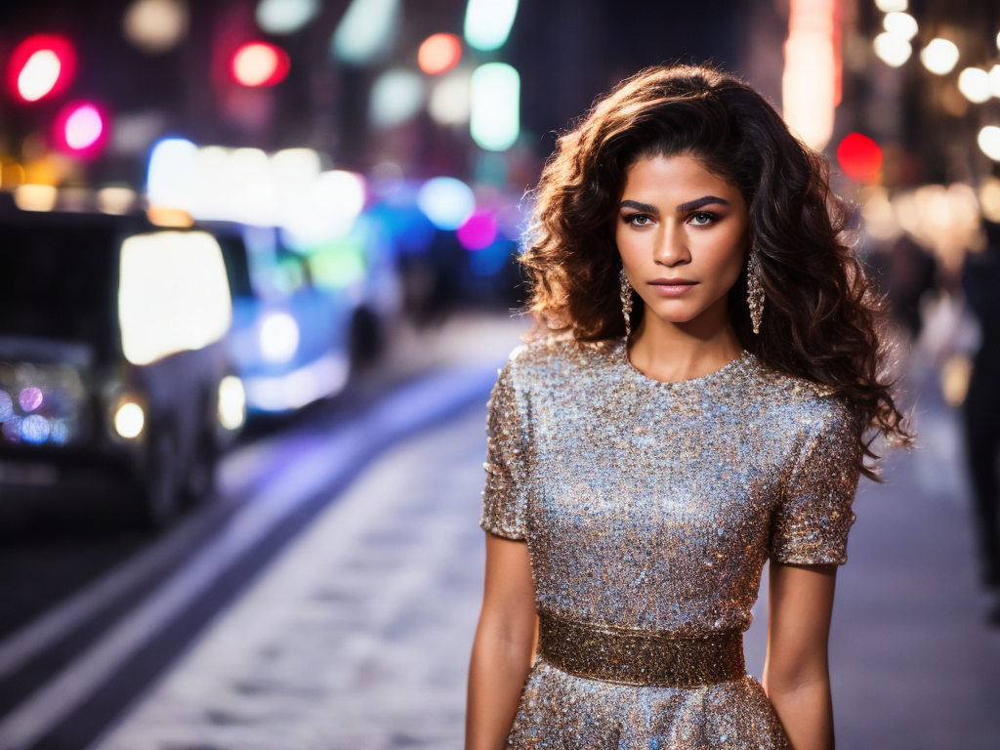

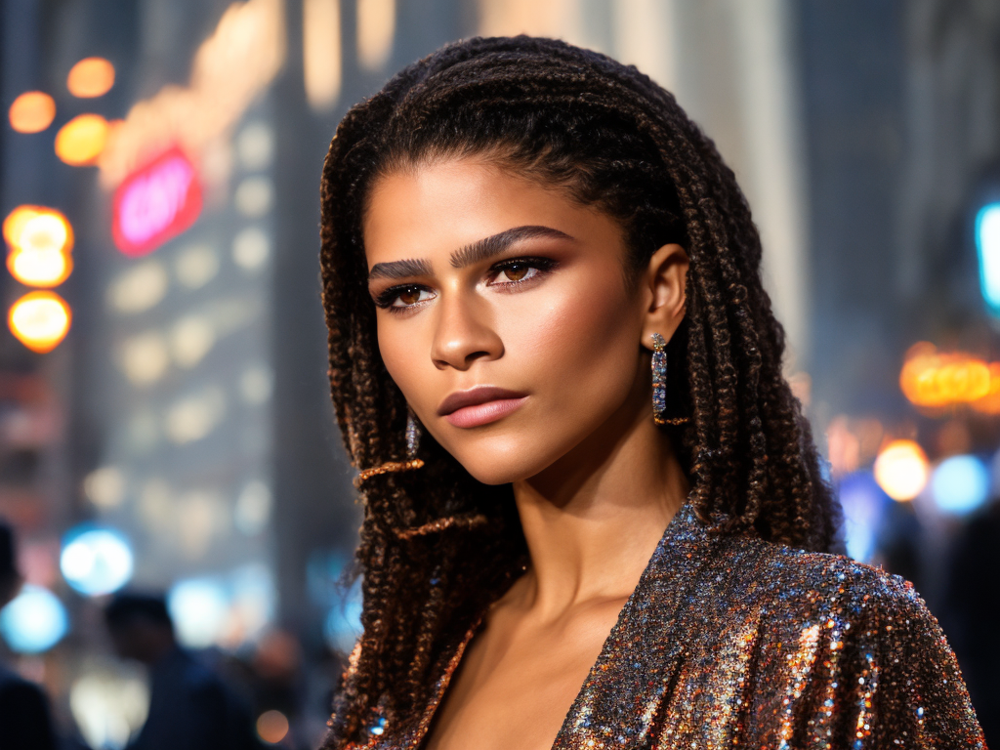

In [53]:
# rank 16
prompt = "portrait of sks woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus, beautiful, young,  beautiful eyes, detailed eyes" #@param {type:"string"}
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation" #@param {type:"string"}
num_samples = 2 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 55 #@param {type:"number"}
height = 768 #@param {type:"number"}
width = 1024 #@param {type:"number"}

with torch.autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

  0%|          | 0/55 [00:00<?, ?it/s]

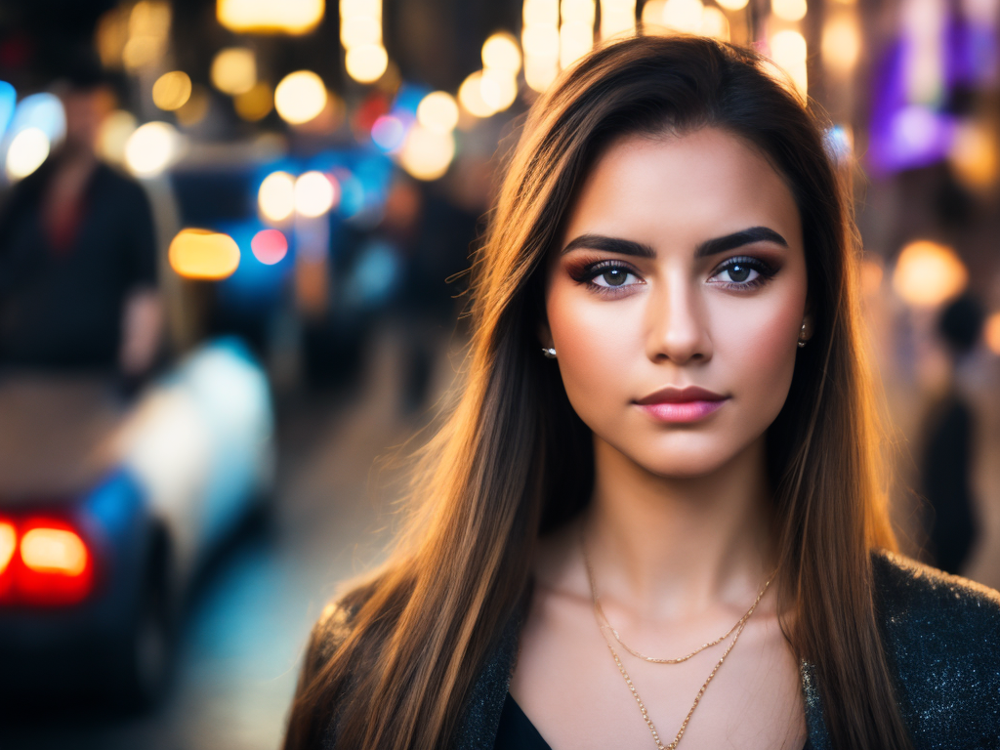

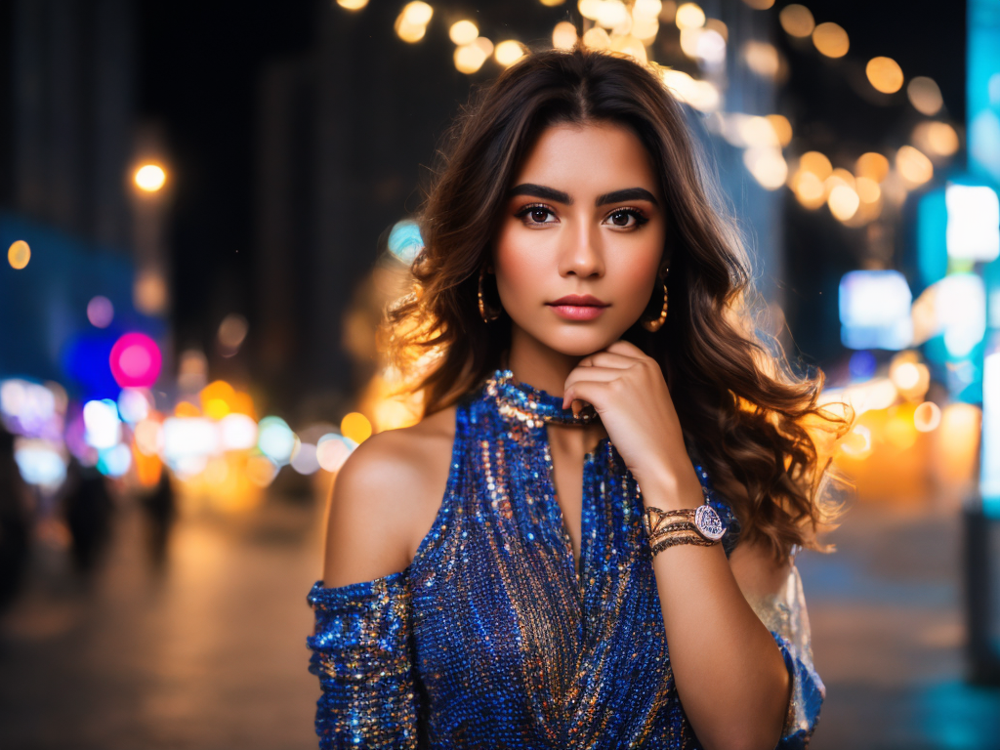

In [54]:
prompt = "portrait of woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus, beautiful, young,  beautiful eyes, detailed eyes" #@param {type:"string"}
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation" #@param {type:"string"}
num_samples = 2 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 55 #@param {type:"number"}
height = 768 #@param {type:"number"}
width = 1024 #@param {type:"number"}

with torch.autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

  0%|          | 0/55 [00:00<?, ?it/s]

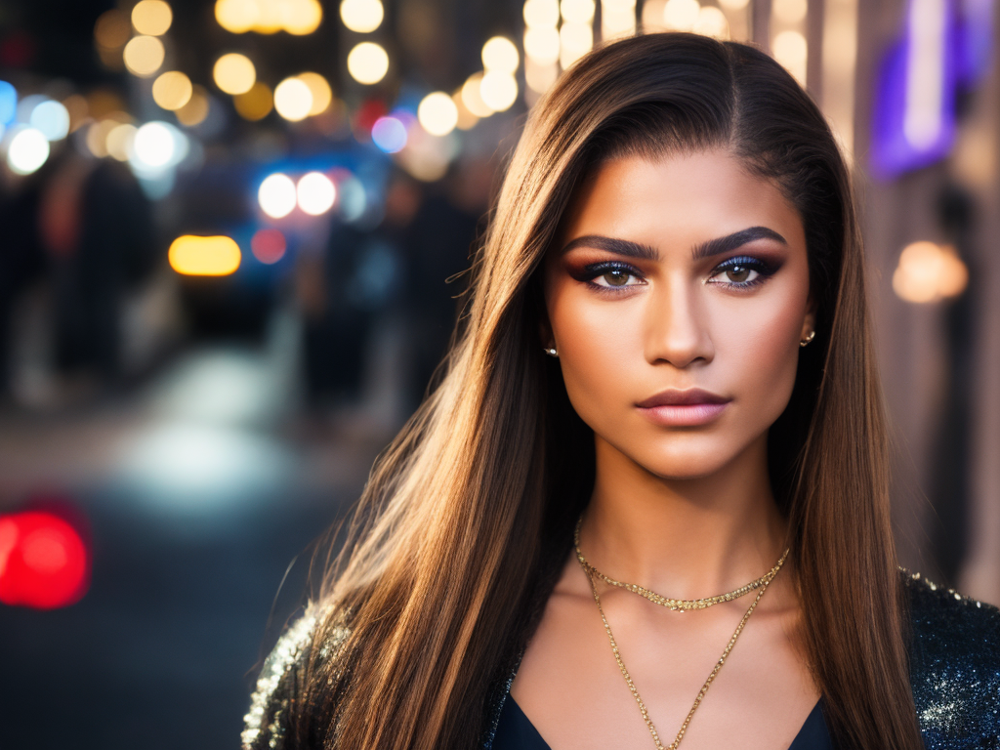

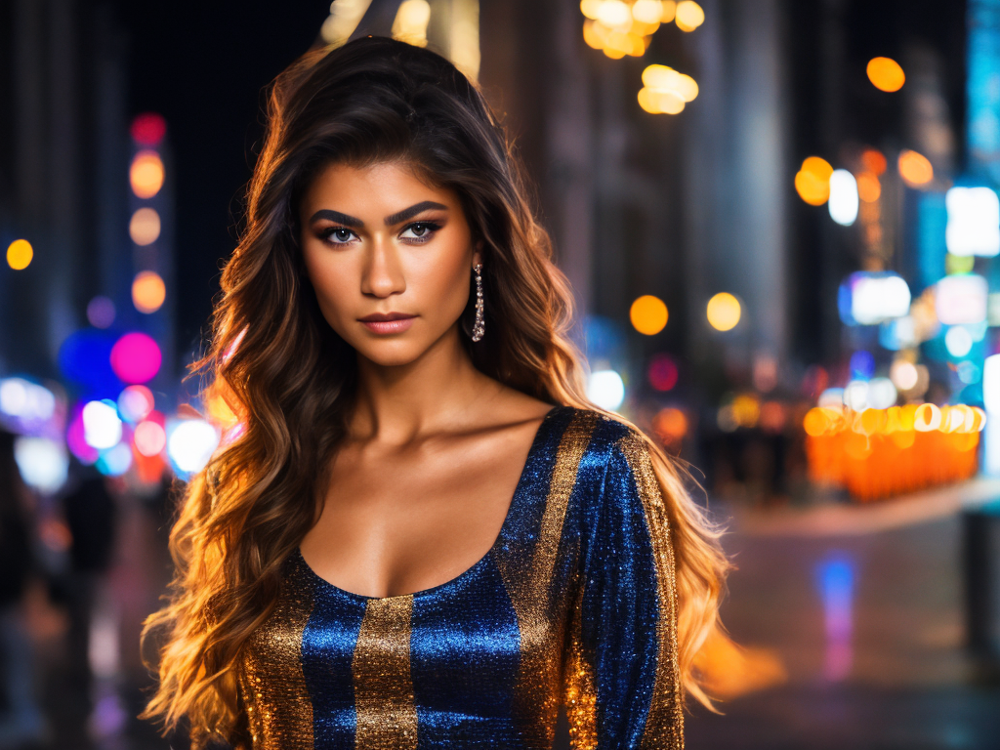

In [44]:
# rank 64
prompt = "portrait of sks woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus, beautiful, young,  beautiful eyes, detailed eyes" #@param {type:"string"}
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation" #@param {type:"string"}
num_samples = 2 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 55 #@param {type:"number"}
height = 768 #@param {type:"number"}
width = 1024 #@param {type:"number"}

with torch.autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

In [37]:
# rank 128

  0%|          | 0/55 [00:00<?, ?it/s]

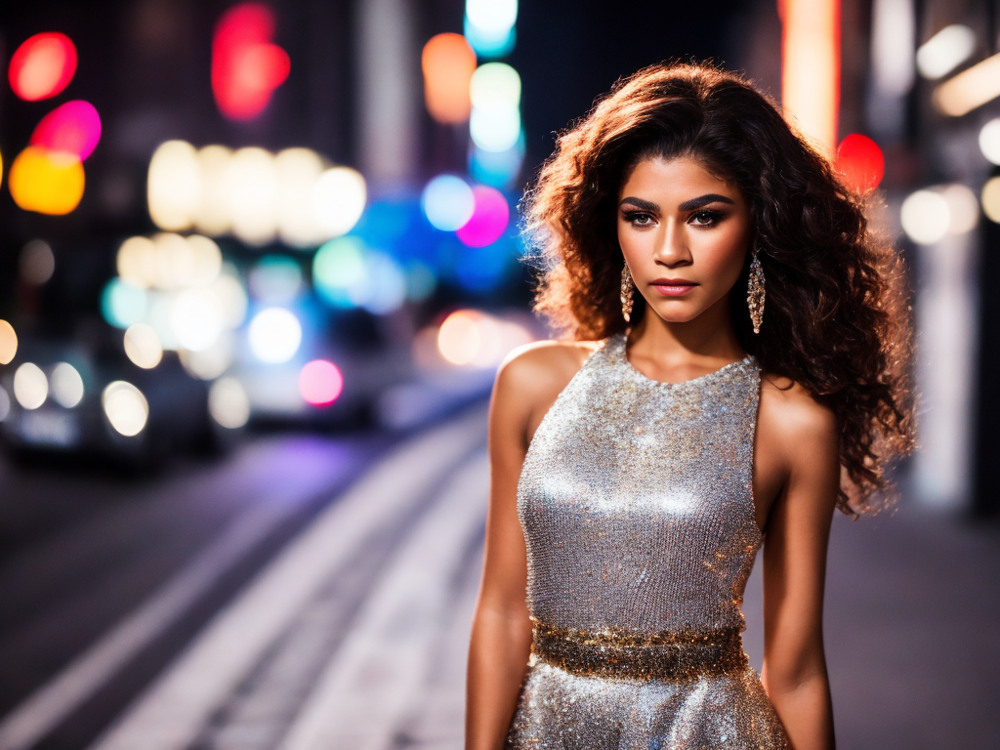

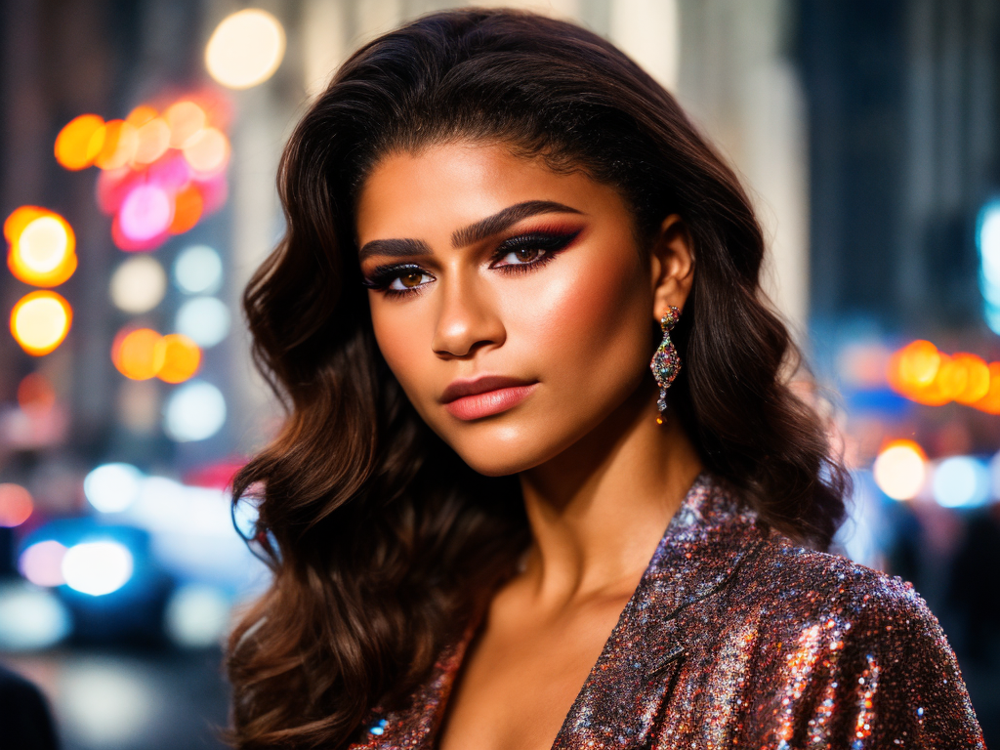

In [38]:
prompt = "portrait of sks woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus, beautiful, young,  beautiful eyes, detailed eyes" #@param {type:"string"}
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation" #@param {type:"string"}
num_samples = 2 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 55 #@param {type:"number"}
height = 768 #@param {type:"number"}
width = 1024 #@param {type:"number"}

with torch.autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

  0%|          | 0/55 [00:00<?, ?it/s]

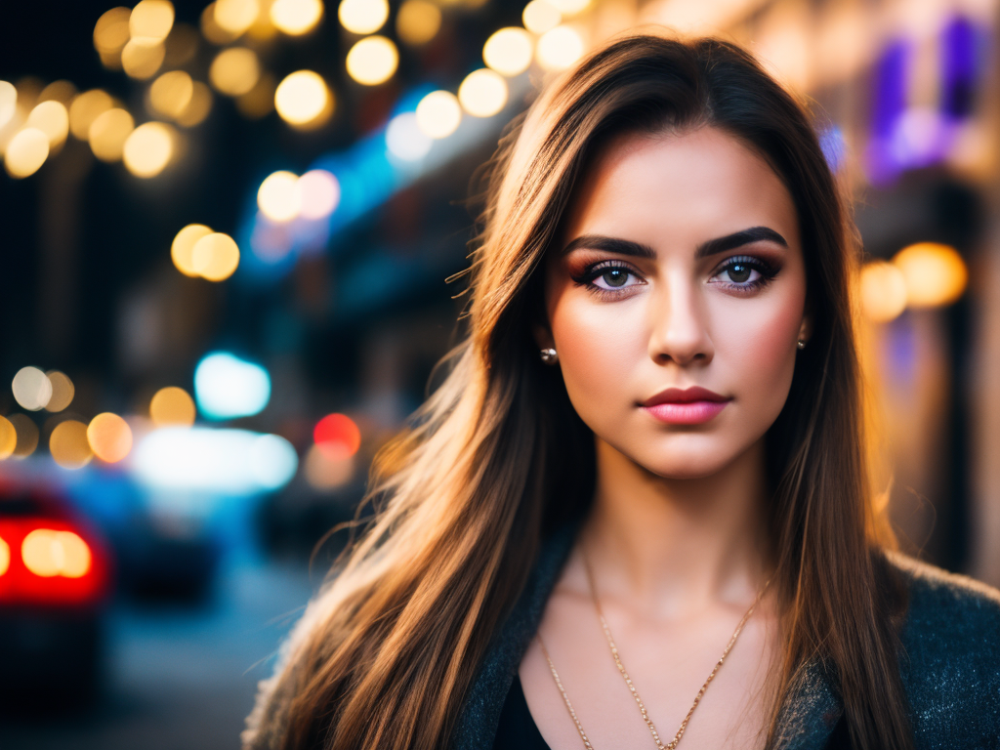

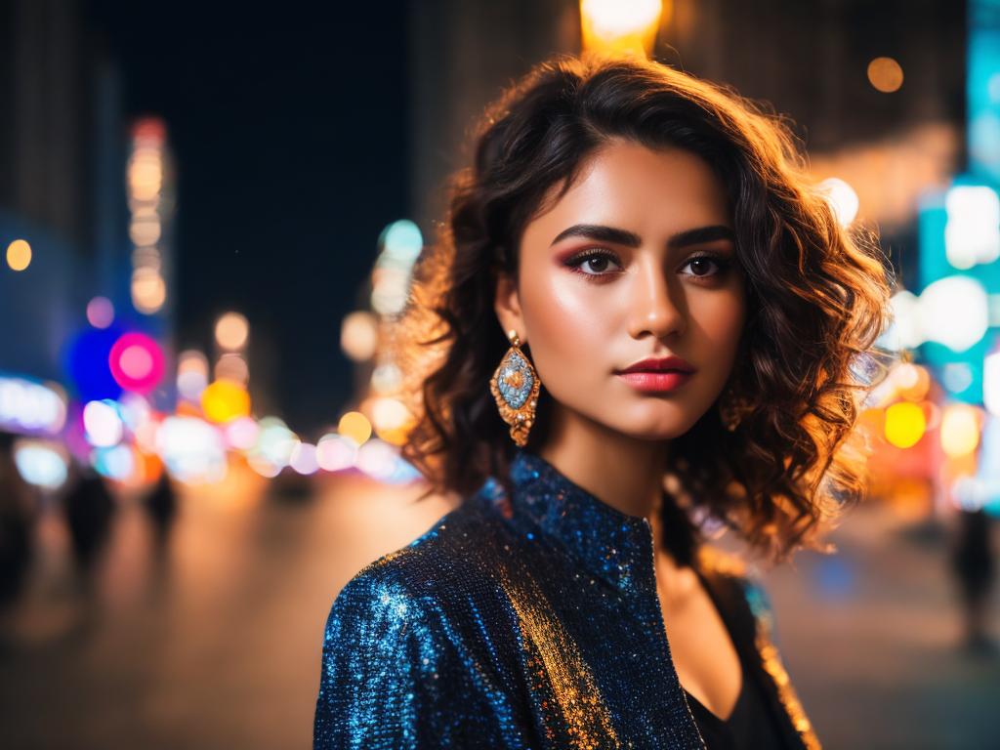

In [39]:
prompt = "portrait of woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus, beautiful, young,  beautiful eyes, detailed eyes" #@param {type:"string"}
negative_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation" #@param {type:"string"}
num_samples = 2 #@param {type:"number"}
guidance_scale = 7.5 #@param {type:"number"}
num_inference_steps = 55 #@param {type:"number"}
height = 768 #@param {type:"number"}
width = 1024 #@param {type:"number"}

with torch.autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    ).images

for img in images:
    display(img)

In [56]:
# !zip -r /kaggle/working/out_lora.zip /kaggle/working/out_lora

  adding: kaggle/working/out_lora/ (stored 0%)
  adding: kaggle/working/out_lora/unet/ (stored 0%)
  adding: kaggle/working/out_lora/unet/adapter_config.json (deflated 53%)
  adding: kaggle/working/out_lora/unet/adapter_model.safetensors (deflated 7%)
  adding: kaggle/working/out_lora/unet/README.md (deflated 66%)
  adding: kaggle/working/out_lora/text_encoder/ (stored 0%)
  adding: kaggle/working/out_lora/text_encoder/adapter_config.json (deflated 52%)
  adding: kaggle/working/out_lora/text_encoder/adapter_model.safetensors (deflated 7%)
  adding: kaggle/working/out_lora/text_encoder/README.md (deflated 66%)
  adding: kaggle/working/out_lora/logs/ (stored 0%)
  adding: kaggle/working/out_lora/logs/dreambooth/ (stored 0%)
  adding: kaggle/working/out_lora/logs/dreambooth/events.out.tfevents.1712258233.a89afa37c3fd.136.0 (deflated 67%)
  adding: kaggle/working/out_lora/logs/dreambooth/1712258233.230707/ (stored 0%)
  adding: kaggle/working/out_lora/logs/dreambooth/1712258233.230707/hpar

In [57]:
token = "sks"
promtp_list = [
    {
     "name": "kitchen",
     "prompt":f"close up portrait of {token} woman face, in the kitchen, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation",
    },
    {
     "name": "forest",
     "prompt":f"portrait of {token} woman face, in the forest, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation",
    },
    {
     "name": "street",
     "prompt":f"portrait of {token} woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
    {
     "name": "desert",
     "prompt":f"portrait of {token} woman face, on the desert, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
    {
     "name": "beach",
     "prompt":f"portrait of {token} woman face, on the beach, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
]

In [62]:
!mkdir /kaggle/working/lora_images

In [63]:
save_folder = "/kaggle/working/lora_images"

In [64]:
seed = 147525234
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 45
height = 768
width = 1024

save_mode = "with_train_token"


for idx, sample in enumerate(promtp_list):
    prompt = sample.get("prompt")
    negative_prompt = sample.get("n_prompt")
    name = sample.get("name")
    generator = torch.Generator("cuda").manual_seed(seed)
    with torch.autocast("cuda"), torch.inference_mode():
        images = pipe(
            prompt,
            height=height,
            width=width,
            negative_prompt=negative_prompt,
            num_images_per_prompt=1,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator
        ).images
    image = images[0]
    
    save_path = os.path.join(save_folder, save_mode)
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    image.save(os.path.join(save_path, f'{height}x{width}_{name}.jpg'))
    
    

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

In [65]:
token = ""
promtp_list = [
    {
     "name": "kitchen",
     "prompt":f"close up portrait of {token} woman face, in the kitchen, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation",
    },
    {
     "name": "forest",
     "prompt":f"portrait of {token} woman face, in the forest, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation",
    },
    {
     "name": "street",
     "prompt":f"portrait of {token} woman face, on the street, lights, midnight, NY, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
    {
     "name": "desert",
     "prompt":f"portrait of {token} woman face, on the desert, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
    {
     "name": "beach",
     "prompt":f"portrait of {token} woman face, on the beach, standing, 4K, raw, hrd, hd, high quality, realism, sharp focus,  beautiful eyes, detailed eyes",
     "n_prompt":"naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands, mutation, ugly, blurry",
    },
]

In [66]:
save_folder

'/kaggle/working/lora_images'

In [67]:
seed = 147525234
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 45
height = 768
width = 1024

save_mode = "base_model"


for idx, sample in enumerate(promtp_list):
    prompt = sample.get("prompt")
    negative_prompt = sample.get("n_prompt")
    name = sample.get("name")
    generator = torch.Generator("cuda").manual_seed(seed)
    with torch.autocast("cuda"), torch.inference_mode():
        images = pipe(
            prompt,
            height=height,
            width=width,
            negative_prompt=negative_prompt,
            num_images_per_prompt=1,
            num_inference_steps=num_inference_steps,
            guidance_scale=guidance_scale,
            generator=generator
        ).images
    image = images[0]
    
    save_path = os.path.join(save_folder, save_mode)
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    image.save(os.path.join(save_path, f'{height}x{width}_{name}.jpg'))
    
    

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

In [69]:
# !zip -r /kaggle/working/lora_images.zip /kaggle/working/lora_images

# Control net 

In [70]:
!pip install -q opencv-contrib-python
!pip install -q controlnet_aux

In [218]:
from diffusers import StableDiffusionControlNetPipeline
from diffusers.utils import load_image

In [73]:
from glob import glob

In [74]:
import cv2
from PIL import Image
import numpy as np

In [75]:
templates = [Image.open(f) for f in glob('/kaggle/input/portrait4ctrlnet/*')]

In [86]:
for t in templates:
    print(t.size)

(726, 1000)
(1013, 1200)
(1024, 1526)


In [87]:
templates = [t.resize(np.array(t.size)//3) for t in templates]

In [121]:
np.array([10, 12]) % 8

array([2, 4])

In [197]:
canny_images = []
low_threshold = 170
high_threshold = 250

for path in glob('/kaggle/input/portrait4ctrlnet/*'):
    
    image = Image.open(path)
    image = image.resize(np.array(image.size) // 2)
    size = np.array(image.size) +  np.array(image.size) % 8
    image = image.resize(size)
    
    image = np.array(image)

    image = cv2.Canny(image, low_threshold, high_threshold)
    image = image[:, :, None]
    image = np.concatenate([image, image, image], axis=2)
    canny_image = Image.fromarray(image)
    canny_images.append(canny_image)

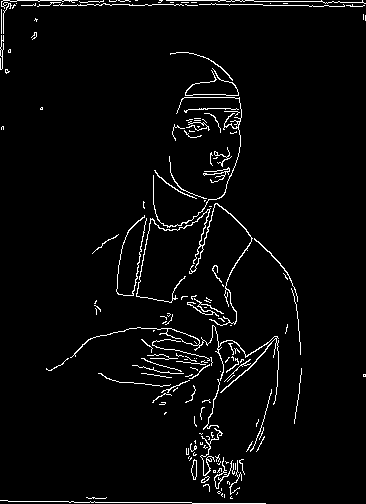

(366, 504)


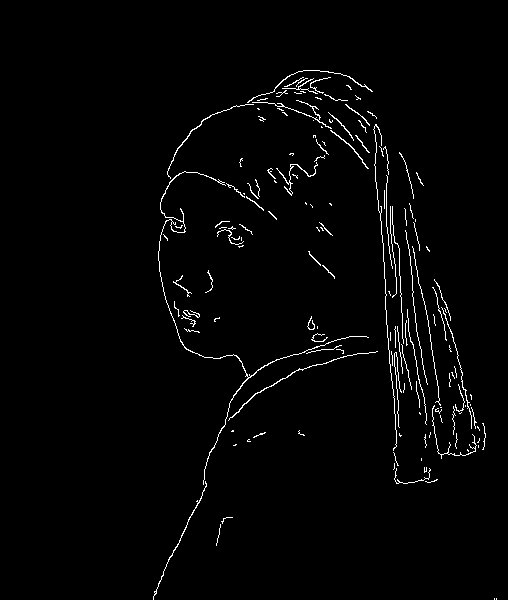

(508, 600)


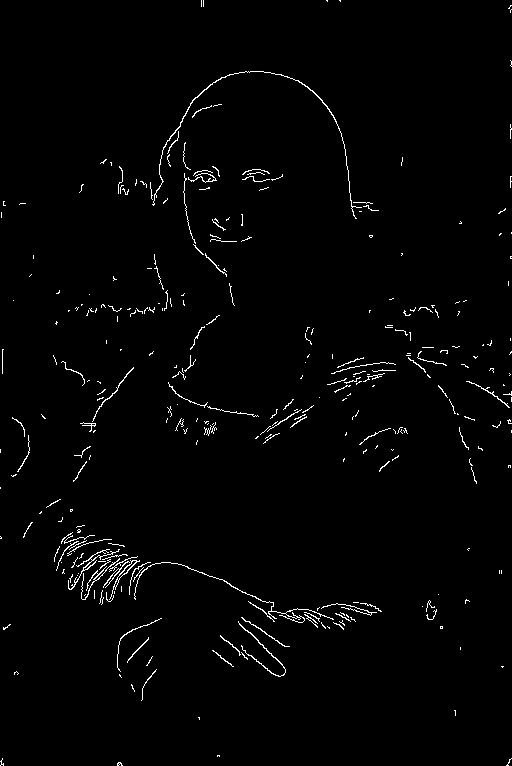

(512, 766)


In [198]:
for canny in canny_images:
    display(canny)
    print(canny.size)

In [101]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel
import torch


controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny",
                                             torch_dtype=torch.float16).to("cuda")

config.json:   0%|          | 0.00/920 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.45G [00:00<?, ?B/s]

In [132]:
pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "/kaggle/working/out/dreambooth",
    controlnet=controlnet,
    torch_dtype=torch.float16).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


In [162]:
from diffusers import UniPCMultistepScheduler

pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)

In [134]:
pipe.enable_model_cpu_offload()

In [105]:
!pip install -q xformers

In [138]:
# pipe.enable_xformers_memory_efficient_attention()

In [135]:
neg_prompt = "naked, nsfw, deformed, distorted, disfigured, poorly drawn, bad anatomy, extra limb, missing limb, floating limbs, mutated hands disconnected limbs, mutation, ugly, blurry, amputation"

In [136]:
pos_promt = "portrait of {} woman face, 4K, raw, hrd, hd, high quality, realism, sharp focus"

In [163]:
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows * cols

    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

In [204]:
prompts = [pos_promt.format(token) for token in ["Rihanna", "Kim Kardashian", "sks"]]
generators = [torch.Generator(device="cpu").manual_seed(2) for i in range(len(prompts))]

In [166]:
# !LD_LIBRARY_PATH=/usr/local/cuda-11.7/lib64

In [167]:
# !pip freeze | grep torch

In [177]:
!mkdir /kaggle/working/control_images
!mkdir /kaggle/working/control_images/lora
!mkdir /kaggle/working/control_images/full

In [178]:
save_dir = "/kaggle/working/control_images/full"

  0%|          | 0/35 [00:00<?, ?it/s]

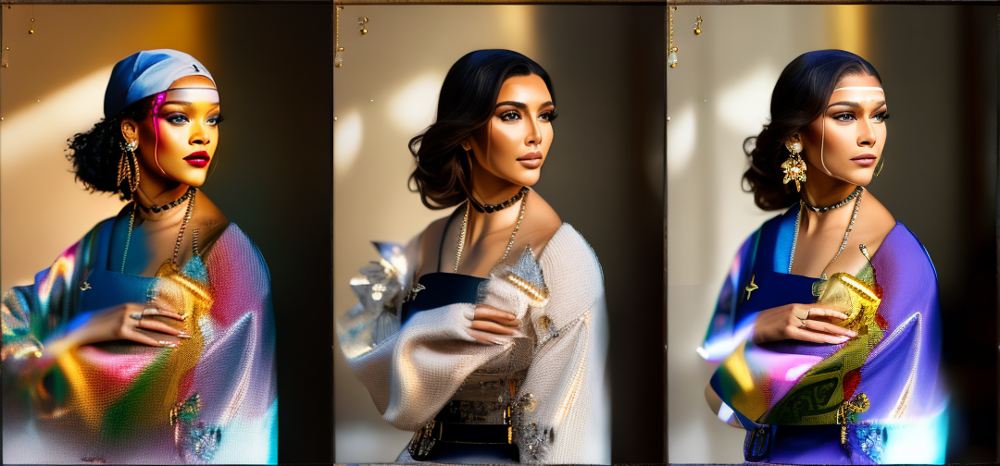

In [205]:
output = pipe(
    prompts,
    canny_images[0],
    negative_prompt=[neg_prompt]*len(prompts),
    generator=generators,
    num_inference_steps=35,
    guidance_scale=7.5,
)

image_grid(output.images, 1, 3)

In [206]:
image_grid(output.images, 1, 3).save(f"{save_dir}/0.jpg")

In [207]:
output = pipe(
    prompts,
    canny_images[1],
    negative_prompt=[neg_prompt]*len(prompts),
    generator=generators,
    num_inference_steps=35,
    guidance_scale=7.5,
)

image_grid(output.images, 1, 3).save(f"{save_dir}/1.jpg")

  0%|          | 0/35 [00:00<?, ?it/s]

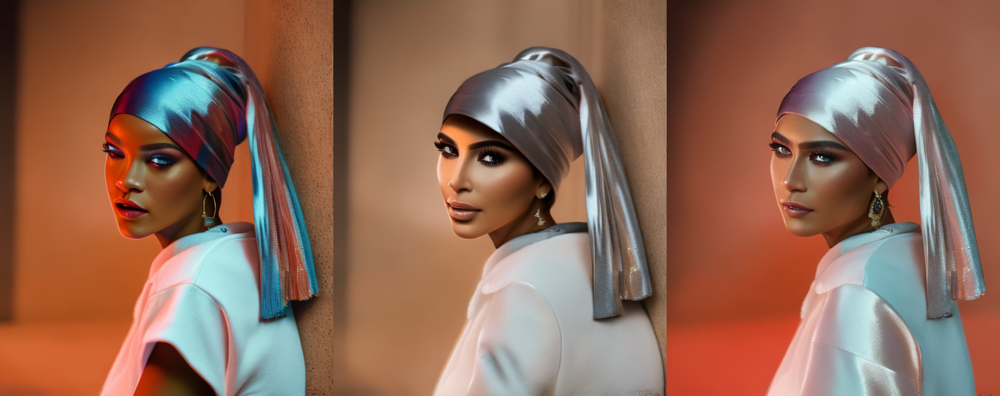

In [209]:
image_grid(output.images, 1, 3)

  0%|          | 0/35 [00:00<?, ?it/s]

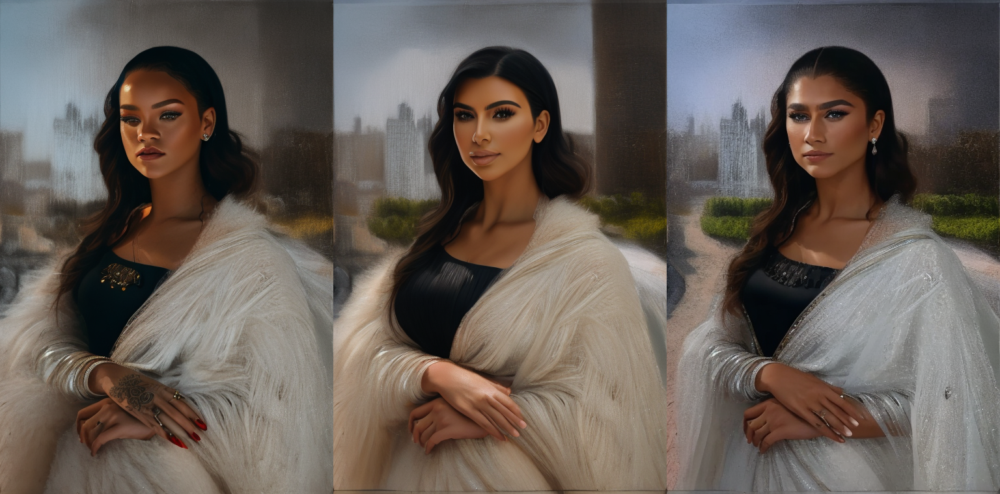

In [210]:
output = pipe(
    prompts,
    canny_images[2],
    negative_prompt=[neg_prompt]*len(prompts),
    generator=generators,
    num_inference_steps=35,
    guidance_scale=7.5,
)

display(image_grid(output.images, 1, 3))
image_grid(output.images, 1, 3).save(f"{save_dir}/2.jpg")

In [213]:
# !zip -r /kaggle/working/control_images/full.zip /kaggle/working/control_images/full

In [214]:
save_dir = "/kaggle/working/control_images/lora"

In [216]:
torch.cuda.empty_cache()

In [222]:
def get_lora_sd_controlnet_pipeline(
    ckpt_dir, base_model_name_or_path=None, dtype=torch.float16, device="cuda", adapter_name="default", controlnet=controlnet,
):
    unet_sub_dir = os.path.join(ckpt_dir, "unet")
    text_encoder_sub_dir = os.path.join(ckpt_dir, "text_encoder")
    if os.path.exists(text_encoder_sub_dir) and base_model_name_or_path is None:
        config = LoraConfig.from_pretrained(text_encoder_sub_dir)
        base_model_name_or_path = config.base_model_name_or_path

    if base_model_name_or_path is None:
        raise ValueError("Please specify the base model name or path")

    pipe = StableDiffusionControlNetPipeline.from_pretrained(base_model_name_or_path, controlnet=controlnet, torch_dtype=dtype).to(device)
    pipe.unet = PeftModel.from_pretrained(pipe.unet, unet_sub_dir, adapter_name=adapter_name)

    if os.path.exists(text_encoder_sub_dir):
        pipe.text_encoder = PeftModel.from_pretrained(
            pipe.text_encoder, text_encoder_sub_dir, adapter_name=adapter_name
        )

    if dtype in (torch.float16, torch.bfloat16):
        pipe.unet.half()
        pipe.text_encoder.half()

    pipe.to(device)
    return pipe

In [220]:
MODEL_NAME

'/kaggle/input/sd-weights/content/cache_dir/models/civitai_model'

In [223]:
pipe = get_lora_sd_controlnet_pipeline("/kaggle/working/out_lora", base_model_name_or_path=MODEL_NAME, adapter_name="person", controlnet=controlnet)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
It seems like you have activated model offloading by calling `enable_model_cpu_offload`, but are now manually moving the pipeline to GPU. It is strongly recommended against doing so as memory gains from offloading are likely to be lost. Offloading automatically takes care of moving the individual components vae, text_encoder, tokenizer, unet, controlnet, scheduler, safety_checker, feature_extractor, image_encoder to GPU when needed. To make sure offloading works as expected, you should consider moving the pipeline back to CPU: `pipeline.to('cpu')` or removing the move altogether if you use offloading.
It seems like you have activated model offloading by calling `enable_model_cpu_offload`, but are now manually moving the pipeline

  0%|          | 0/35 [00:00<?, ?it/s]

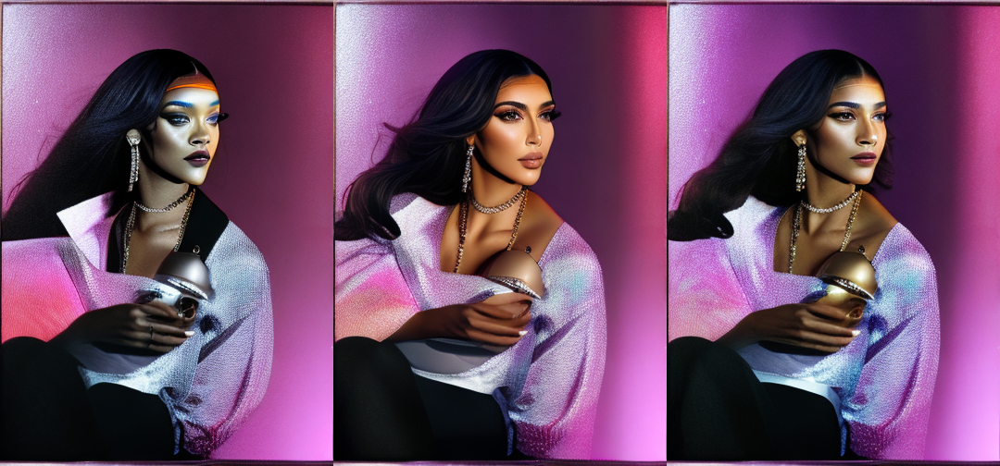

In [224]:
output = pipe(
    prompts,
    canny_images[0],
    negative_prompt=[neg_prompt]*len(prompts),
    generator=generators,
    num_inference_steps=35,
    guidance_scale=7.5,
)

display(image_grid(output.images, 1, 3))
image_grid(output.images, 1, 3).save(f"{save_dir}/0.jpg")

  0%|          | 0/35 [00:00<?, ?it/s]

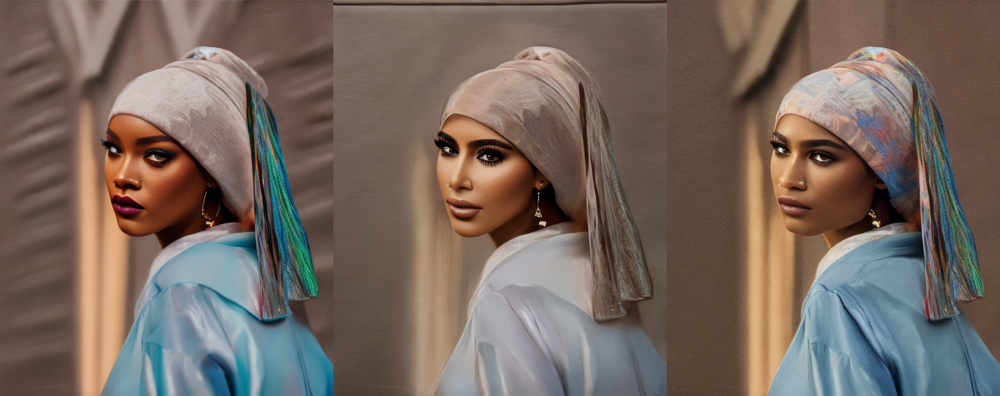

In [225]:
output = pipe(
    prompts,
    canny_images[1],
    negative_prompt=[neg_prompt]*len(prompts),
    generator=generators,
    num_inference_steps=35,
    guidance_scale=7.5,
)

display(image_grid(output.images, 1, 3))
image_grid(output.images, 1, 3).save(f"{save_dir}/1.jpg")

  0%|          | 0/35 [00:00<?, ?it/s]

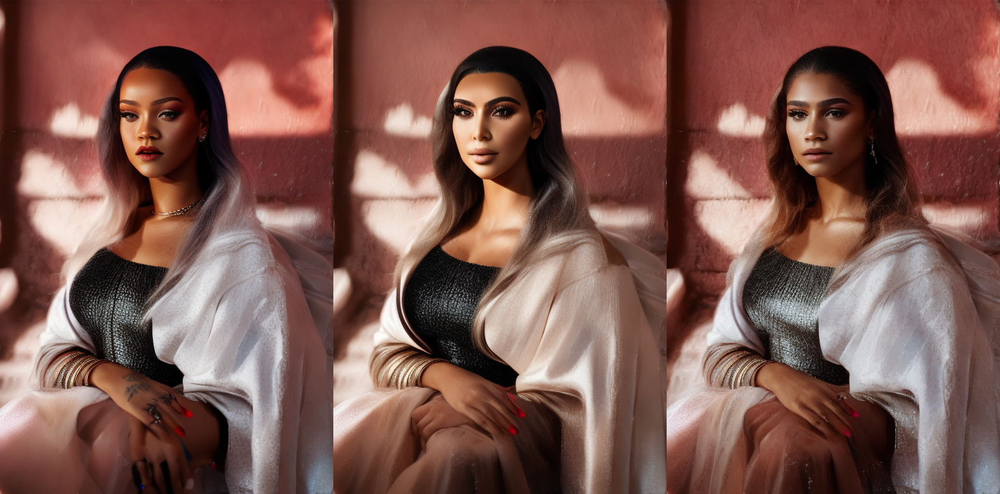

In [227]:
output = pipe(
    prompts,
    canny_images[2],
    negative_prompt=[neg_prompt]*len(prompts),
    generator=generators,
    num_inference_steps=35,
    guidance_scale=7.5,
)

display(image_grid(output.images, 1, 3))
image_grid(output.images, 1, 3).save(f"{save_dir}/2.jpg")

In [228]:
!zip -r /kaggle/working/control_images.zip /kaggle/working/control_images

  adding: kaggle/working/control_images/ (stored 0%)
  adding: kaggle/working/control_images/full.zip (stored 0%)
  adding: kaggle/working/control_images/full/ (stored 0%)
  adding: kaggle/working/control_images/full/1.jpg (deflated 2%)
  adding: kaggle/working/control_images/full/2.jpg (deflated 0%)
  adding: kaggle/working/control_images/full/0.jpg (deflated 0%)
  adding: kaggle/working/control_images/lora/ (stored 0%)
  adding: kaggle/working/control_images/lora/1.jpg (deflated 0%)
  adding: kaggle/working/control_images/lora/2.jpg (deflated 0%)
  adding: kaggle/working/control_images/lora/0.jpg (deflated 0%)
